In [1]:
#############load necessary libraries##############
# %env MY_ENV_VAR="~/.conda/envs/scenic_protocol/:~/.local/bin/"

import os
# os.environ["MY_ENV_VAR"]
os.environ["MKL_NUM_THREADS"] = "30"
os.environ["NUMEXPR_NUM_THREADS"] = "30"
os.environ["OMP_NUM_THREADS"] = "30"


import os, glob, re, pickle
import scanpy as sc
import pandas as pd
import numpy as np
import scanpy.external as sce
import re
from sklearn.metrics import pairwise_distances
import seaborn as sns
import matplotlib.pyplot as pl
import matplotlib.colors as colors
import operator as op
import anndata as ada
import loompy as lp
#import celloracle as co
import pyarrow



from functools import partial
from collections import OrderedDict
from cytoolz import compose
from pyscenic.export import export2loom, add_scenic_metadata
from pyscenic.utils import load_motifs
from pyscenic.transform import df2regulons
from pyscenic.aucell import aucell
from pyscenic.binarization import binarize
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_binarization, plot_rss

from IPython.display import HTML, display



%matplotlib inline
from matplotlib import pyplot as plt

pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', None)
sc.set_figure_params(dpi = 150, dpi_save = 150, format = 'png')
sc._settings.ScanpyConfig(verbosity=1)


import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

np.random.seed(44)

In [ ]:
#############load necessary libraries##############

import os
os.environ["MKL_NUM_THREADS"] = "50"
os.environ["NUMEXPR_NUM_THREADS"] = "50"
os.environ["OMP_NUM_THREADS"] = "50"

import scanpy as sc
import scvelo as scv
import pandas as pd
import numpy as np
import scanpy.external as sce
import cellrank as cr
#import phate
import re
#import torch
#import scarches as sca
#from scarches.dataset.trvae.data_handling import remove_sparsity
#import gdown
from sklearn.metrics import pairwise_distances
import seaborn as sns
import matplotlib.pyplot as pl
import matplotlib.colors as colors
#import scvi
#import scib



%matplotlib inline
from matplotlib import pyplot as plt

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
sc.set_figure_params(dpi = 150, dpi_save = 150, format = 'png')
sc._settings.ScanpyConfig(verbosity=0)

scv.settings.presenter_view = True  # set max width size for presenter view
scv.set_figure_params('scvelo')
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=UserWarning)

np.random.seed(44)

In [2]:
######### load dorsal time points #####

d5d = sc.read_h5ad("/home/kgr851/seurat_data_for_python/velocity/adata/raw/scvi/d5d/d5d.velocity.raw.h5ad")

d9d = sc.read_h5ad("/home/kgr851/seurat_data_for_python/velocity/adata/raw/scvi/d9d/d9d.velocity.raw.h5ad")

d14d = sc.read_h5ad("/home/kgr851/seurat_data_for_python/velocity/adata/raw/scvi/d14d/d14d.velocity.raw.h5ad")


In [3]:
###########provide annotations to seeurat clusters########

d5d.obs['annotations'] = d5d.obs['seurat_clusters'].astype('category')
d9d.obs['annotations'] = d9d.obs['seurat_clusters'].astype('category')
d14d.obs['annotations'] = d14d.obs['seurat_clusters'].astype('category')

new_cluster_names_d5d = ['d5_Neuroepithelium undefined 0',
'd5_Rostral neuroepithelium 1',
'd5_Presumptive Forebrain 2',
'd5_Early caudal neuroectoderm 3',
'd5_Presumptive Hindbrain 4',
'd5_Presumptive Midbrain 5',
'd5_Neuroepithelium, undefined 6',
'd5_Presumptive Forebrain 7']


new_cluster_names_d9d = ['d9_Hindbrain 0',
'd9_FB Presumptive Diencephalon 1',
'd9_Caudal  MHB 2',
'd9_Rostral  MHB 3',
'd9_Hindbrain 4',
'd9_FB Presumptive Telencephalon 5',
'd9_undefined 6',
'd9_Forebrain 7',
'd9_MHB Hindbrain side 8',
'd9_Neuronal precursors 9',
'd9_Neural Crest 10'
]


new_cluster_names_d14d = ["d14_Diencephalon 0",
"d14_Roof plate of rhombomere 6 1",
"d14_Anterior hindbrain, cycling 2",
"d14_MHB_WNT1  3",
"d14_Thalamus 4",
"d14_MHB_FGF17 5",
"d14_Diencephalon, p1 6",
"d14_Anterior hindbrain 7",
"d14_Hindbrain neurons 8",
"d14_Proliferating forebrain 9",
"d14_Hindbrain something 10",
"d14_Dorsal telencephalon cycling 11",
"d14_Proliferating forebrain 12",
"d14_Alar plate of prosomere 2 13",
"d14_Neural crest 14",
"d14_Progenitors leaving CC 15",
"d14_Roof plate midbrain 16"]



d5d.rename_categories('annotations', new_cluster_names_d5d)
d5d.obs["Subclass"] = d5d.obs["annotations"]


d9d.rename_categories('annotations', new_cluster_names_d9d)
d9d.obs["Subclass"] = d9d.obs["annotations"]


d14d.rename_categories('annotations', new_cluster_names_d14d)
d14d.obs["Subclass"] = d14d.obs["annotations"]


In [4]:
#########add meta data for day#########


d5d.obs['day'] =  "day 05"

d9d.obs['day'] =  "day 09"

d14d.obs['day'] =  "day 14"


#########add meta data for tissue #########

d5d.obs['tissue'] = "R/C dorsal d 05"

d9d.obs['tissue'] = "R/C dorsal d 09"

d14d.obs['tissue'] = "R/C dorsal d 14"


#########add meta data for chemistry #########
d5d.obs['chemistry'] = "v3.0"

d9d.obs['chemistry'] = "v3.0"

d14d.obs['chemistry'] = "v2.0"

In [5]:
d5d.layers["counts"] = d5d.X.copy()
d9d.layers["counts"] = d9d.X.copy()
d14d.layers["counts"] = d14d.X.copy()

In [6]:
#############define necessary functions##############

def PreProcessing(obj, QCplots=False, Verbosity="high"):
    obj = obj

    sc.pp.normalize_total(obj,layers=None)
    if Verbosity=="high":
        print("Normalized")
        #print(obj.X[:10,:10])

    sc.pp.log1p(obj, layer = None)
    if Verbosity=="high":
        print("Log transformed")
        #print(obj.X[:10,:10])

    
    return(obj)


def cellcycle(adata):
    S_phase_genes = pd.read_csv('/home/kgr851/new_analysis_new_cc/cc/s.txt',header = None)[0].tolist()
    G2M_phase_genes = pd.read_csv('/home/kgr851/new_analysis_new_cc/cc/g2m.txt',header = None)[0].tolist()
    print("Regressing individual phases")
    sc.pp.scale(adata)
    sc.tl.score_genes_cell_cycle(adata, s_genes=S_phase_genes, g2m_genes=G2M_phase_genes)
    sc.pp.regress_out(adata, ['S_score', 'G2M_score'],n_jobs = 10)
    sc.pp.scale(adata)

    return(adata)


In [8]:
####pre processing 

d5d = PreProcessing(d5d)
d9d = PreProcessing(d9d)
d14d = PreProcessing(d14d)


Normalized
Log transformed
Normalized
Log transformed
Normalized
Log transformed


In [9]:
#####concatenate all datasets ######
adata_d5_d14 = d5d.concatenate(d9d,d14d,batch_categories=['d5d','d9d','d14d'])

In [10]:
adata_d5_d14.obs['source'] =  adata_d5_d14.obs['tissue']

In [11]:
adata_d5_d14 = cellcycle(adata_d5_d14)

Regressing individual phases


In [12]:
#### rady for ingest based integration####### https://scanpy.readthedocs.io/en/stable/tutorials/basics/integrating-data-using-ingest.html
adata_ref = adata_d5_d14[adata_d5_d14.obs.batch == 'd14d']

In [13]:
sc.pp.pca(adata_ref)
sc.pp.neighbors(adata_ref)
sc.tl.umap(adata_ref)

/home/kgr851/.conda/envs/scenic_protocol/lib/python3.7/site-packages/numba/core/typed_passes.py:330: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see https://numba.readthedocs.io/en/stable/user/parallel.html#diagnostics for help.

File "../../../../.local/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/kgr851/.local/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see https://numba.readthedocs.io/en/stable/user/parallel.html#diagnostics for help.

File "../../../../.local/lib/python3.7/site-packages

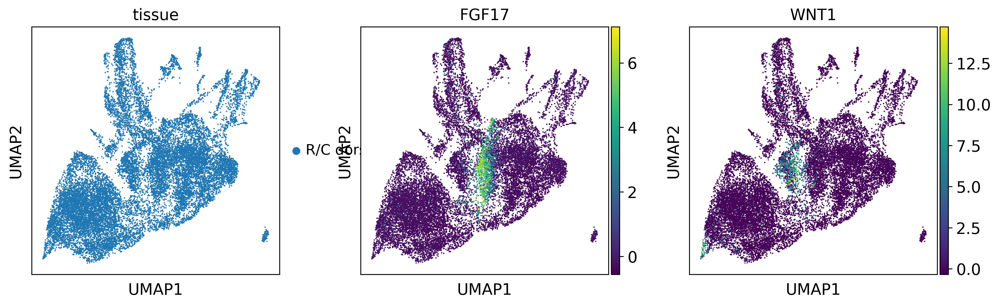

In [212]:
sc.pl.umap(adata_ref, color=['tissue','FGF17','WNT1'])

In [15]:
adatas = [adata_d5_d14[adata_d5_d14.obs.batch == i].copy() for i in ['d5d','d9d']]

In [16]:
adata_concat = adata_d5_d14.copy()

In [17]:
sc.settings.verbosity = 1  # a bit more logging
for iadata, adata in enumerate(adatas):
    print(f'... integrating batch {iadata+1}')
    adata.obs['celltype_orig'] = adata.obs.day  # save the original cell type
    sc.tl.ingest(adata, adata_ref, obs='day')

... integrating batch 1


/home/kgr851/.conda/envs/scenic_protocol/lib/python3.7/site-packages/numba/core/typed_passes.py:330: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see https://numba.readthedocs.io/en/stable/user/parallel.html#diagnostics for help.

File "../../../../.local/lib/python3.7/site-packages/umap/nndescent.py", line 124:
    @numba.njit(parallel=True)
    def init_from_random(n_neighbors, data, query_points, heap, rng_state):
    ^

  state.func_ir.loc))
/home/kgr851/.conda/envs/scenic_protocol/lib/python3.7/site-packages/numba/core/typed_passes.py:330: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see https://numba.readthedocs.io/en/stable/user/parallel.html#diagnostics for help.

File "../../../../.local/li

... integrating batch 2


/home/kgr851/.conda/envs/scenic_protocol/lib/python3.7/site-packages/numba/core/typed_passes.py:330: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see https://numba.readthedocs.io/en/stable/user/parallel.html#diagnostics for help.

File "../../../../.local/lib/python3.7/site-packages/umap/nndescent.py", line 124:
    @numba.njit(parallel=True)
    def init_from_random(n_neighbors, data, query_points, heap, rng_state):
    ^

  state.func_ir.loc))
/home/kgr851/.conda/envs/scenic_protocol/lib/python3.7/site-packages/numba/core/typed_passes.py:330: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see https://numba.readthedocs.io/en/stable/user/parallel.html#diagnostics for help.

File "../../../../.local/li

In [18]:
adata.obs.head(10)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_HTO,nFeature_HTO,HTO_maxID,HTO_secondID,HTO_margin,HTO_classification,HTO_classification.global,hash.ID,percent.mt,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT,SCT_snn_res.0.4,seurat_clusters,day,model,tissue,source,initial_size_spliced,initial_size_unspliced,initial_size,annotations,Subclass,chemistry,SCT_snn_res.0.6,batch,S_score,G2M_score,phase,celltype_orig
AAACCCAAGAGTGAAG-d9d,0,10146.0,2955,12.0,3.0,HTO2-TGATGGCCTATTGGG,HTO3-TTCCGCCTCTCTTTG,0.471861,Negative,Negative,1.0,3.025823,-0.005168,0.188261,G2M,7401.0,2860,3.0,3,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,7994.0,2893.0,9969.0,d9_Rostral MHB 3,d9_Rostral MHB 3,v3.0,NaN,d9d,-0.129716,0.222548,G2M,day 09
AAACCCAAGGGTGGGA-d9d,0,8774.0,2542,29.0,4.0,HTO2-TGATGGCCTATTGGG,HTO4-AGTAAGTTCAGCGTA,1.101750,HTO2-TGATGGCCTATTGGG,Singlet,2.0,3.555961,-0.154906,-0.255889,G1,7327.0,2478,5.0,5,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,6900.0,2088.0,8614.0,d9_FB Presumptive Telencephalon 5,d9_FB Presumptive Telencephalon 5,v3.0,NaN,d9d,-0.359514,-0.443020,G1,day 09
AAACCCAAGTATGATG-d9d,0,11197.0,2788,19.0,4.0,HTO4-AGTAAGTTCAGCGTA,HTO1-GTCAACTCTTTAGCG,0.561722,HTO4-AGTAAGTTCAGCGTA,Singlet,3.0,3.724212,-0.109240,-0.165178,G1,7404.0,2697,0.0,0,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,8900.0,3407.0,11005.0,d9_Hindbrain 0,d9_Hindbrain 0,v3.0,NaN,d9d,-0.329287,-0.303424,G1,day 09
AAACCCACAATCGCAT-d9d,0,14286.0,3415,14.0,4.0,HTO5-AAGTATCGTTTCGCA,HTO4-AGTAAGTTCAGCGTA,0.695971,Negative,Negative,1.0,3.576928,-0.171223,-0.247566,G1,7775.0,3315,4.0,4,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,11363.0,2954.0,14023.0,d9_Hindbrain 4,d9_Hindbrain 4,v3.0,NaN,d9d,-0.446118,-0.503934,G1,day 09
AAACCCACATATTCGG-d9d,0,20065.0,3565,89.0,5.0,HTO5-AAGTATCGTTTCGCA,HTO2-TGATGGCCTATTGGG,2.591661,HTO5-AAGTATCGTTTCGCA,Singlet,4.0,3.149763,0.179951,-0.116387,S,8662.0,3467,2.0,2,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,15997.0,2734.0,19672.0,d9_Caudal MHB 2,d9_Caudal MHB 2,v3.0,NaN,d9d,0.142193,-0.316470,S,day 09
AAACCCAGTGAGTAAT-d9d,0,3529.0,1761,22.0,5.0,HTO1-GTCAACTCTTTAGCG,HTO5-AAGTATCGTTTCGCA,1.000340,HTO1-GTCAACTCTTTAGCG,Singlet,5.0,11.277982,0.156878,0.169477,G2M,6823.0,2286,7.0,7,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,2748.0,2126.0,3460.0,d9_Forebrain 7,d9_Forebrain 7,v3.0,NaN,d9d,0.080466,0.135437,G2M,day 09
AAACCCAGTGTAAACA-d9d,0,14810.0,3265,43.0,4.0,HTO3-TTCCGCCTCTCTTTG,HTO1-GTCAACTCTTTAGCG,1.654340,HTO3-TTCCGCCTCTCTTTG,Singlet,6.0,3.943282,0.122072,0.044705,S,7931.0,3165,2.0,2,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,11875.0,3362.0,14548.0,d9_Caudal MHB 2,d9_Caudal MHB 2,v3.0,NaN,d9d,0.190830,-0.028786,S,day 09
AAACCCAGTGTACAGG-d9d,0,7132.0,2305,37.0,5.0,HTO2-TGATGGCCTATTGGG,HTO5-AAGTATCGTTTCGCA,1.253455,HTO2-TGATGGCCTATTGGG,Singlet,2.0,9.604599,0.329638,0.132837,S,7573.0,2364,1.0,1,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,5584.0,1716.0,7013.0,d9_FB Presumptive Diencephalon 1,d9_FB Presumptive Diencephalon 1,v3.0,NaN,d9d,0.408794,0.126357,S,day 09
AAACGAAAGAACAGGA-d9d,0,20154.0,3881,23.0,5.0,HTO4-AGTAAGTTCAGCGTA,HTO5-AAGTATCGTTTCGCA,1.526673,HTO4-AGTAAGTTCAGCGTA,Singlet,3.0,7.750323,0.042761,0.984370,G2M,9017.0,3781,2.0,2,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,15883.0,2529.0,19761.0,d9_Caudal MHB 2,d9_Caudal MHB 2,v3.0,NaN,d9d,0.071508,1.958897,G2M,day 09
AAACGAAAGAGAGAAC-d9d,0,4921.0,1886,27.0,5.0,HTO5-AAGTATCGTTTCGCA,HTO1-GTCAACTCTTTAGCG,1.070439,HTO5-AAGTATCGTTTCGCA,Singlet,4.0,2.885592,0.373987,0.102829,S,7127.0,2194,4.0,4,day 14,R/C dorsal,R/C dorsal d 09,R/C dorsal d 09,3971.0,1346.0,4822.0,d9_Hindbrain 4,d9_Hindbrain 4,v3.0,NaN,d9d,0.381975,0.119127,S,day 09


In [19]:
adata_concat = adata_ref.concatenate(adatas)


In [20]:
# adata_concat.obs.celltype = adata_concat.obs.celltype.astype('category')
# adata_concat.obs.celltype.cat.reorder_categories(adata_ref.obs.celltype.cat.categories, inplace=True)  # fix category ordering
# adata_concat.uns['celltype_colors'] = adata_ref.uns['celltype_colors']  # fix category coloring

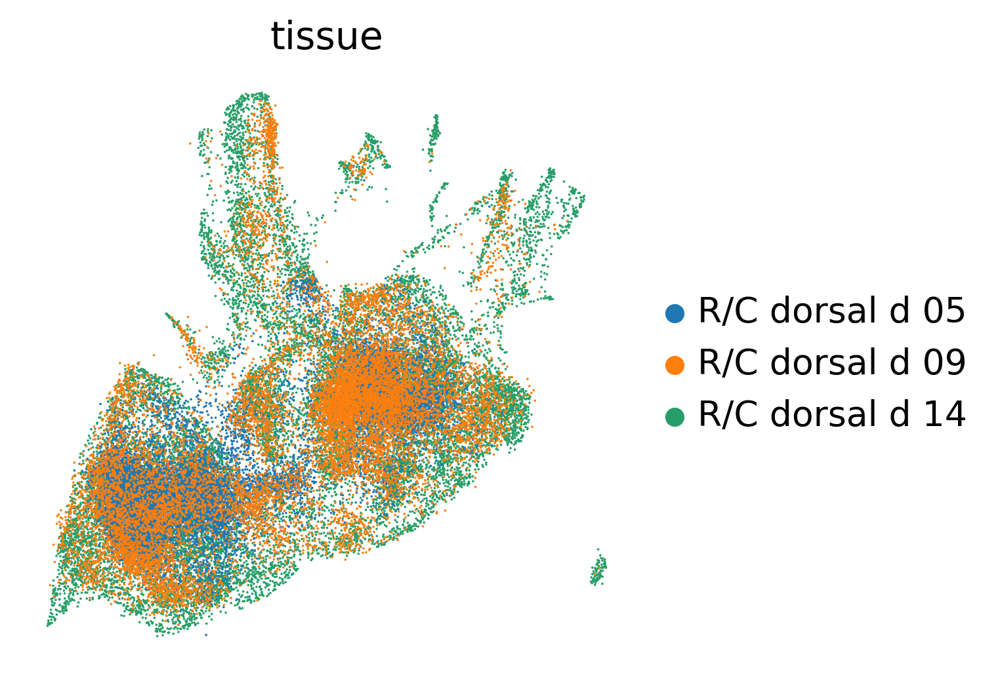

In [21]:
sc.pl.umap(adata_concat, color=['tissue'], vmax = 1, wspace = 0.3, frameon=False, size = 3, save = 'd5_9_14_ingest.svg')

In [22]:
##### score MHB related genes for MHB trajectory #### scoring idea inspired from https://github.com/linnarsson-lab/developing-human-brain/blob/main/notebooks/Figure4_Subpallium_lineage.ipynb
MHB_genes = ['PAX2','PAX8','FGF17','WNT1','FGF8','EN1']
sc.tl.score_genes(adata_concat,MHB_genes,score_name='MHB_score')

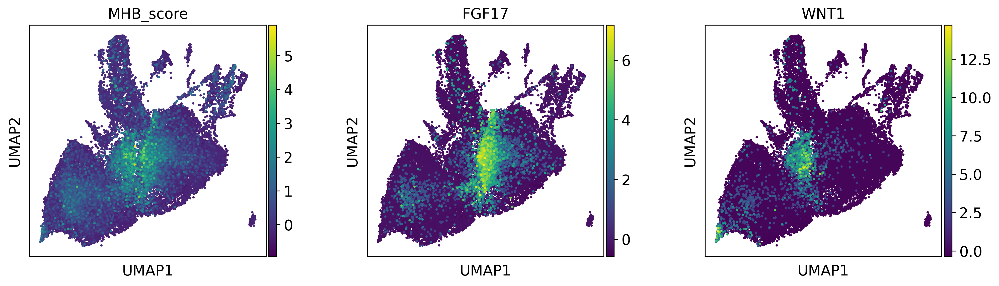

In [23]:
##### plotting ###
sc.pl.umap(adata_concat, color=['MHB_score','FGF17','WNT1'], wspace = 0.3, size = 20)

In [237]:
##### save the adta for future###
adata_concat.write('adata_concat_MHB_main.h5ad')

In [246]:
adata_concat

AnnData object with n_obs × n_vars = 48728 × 20686
    obs: 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.4', 'seurat_clusters', 'day', 'model', 'tissue', 'source', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'annotations', 'Subclass', 'chemistry', 'SCT_snn_res.0.6', 'batch', 'S_score', 'G2M_score', 'phase', 'celltype_orig', 'MHB_score', 'MHB'
    var: 'highly_variable', 'gene_ids', 'feature_types', 'mean', 'std'
    uns: 'tissue_colors', 'dendrogram_tissue'
    obsm: 'X_umap', 'X_pca'
    layers: 'ambiguous', 'spliced', 'unspliced', 'counts'

In [24]:
##### subset MHB cells
adata_concat.obs['MHB'] = (adata_concat.obs['MHB_score']>0.05).astype(int)

In [25]:
adata_concat.obs.head(2)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_HTO,nFeature_HTO,HTO_maxID,HTO_secondID,HTO_margin,HTO_classification,HTO_classification.global,hash.ID,percent.mt,S.Score,G2M.Score,Phase,nCount_SCT,nFeature_SCT,SCT_snn_res.0.4,seurat_clusters,day,model,tissue,source,initial_size_spliced,initial_size_unspliced,initial_size,annotations,Subclass,chemistry,SCT_snn_res.0.6,batch,S_score,G2M_score,phase,celltype_orig,MHB_score,MHB
AAACCTGAGACAAGCC_1-d14d-0,d14d.1,8075.0,2412,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.226006,0.088747,0.216926,G2M,5859.0,2316,NaN,10,day 14,R/C dorsal,R/C dorsal d 14,R/C dorsal d 14,5105.0,715.0,8063.0,d14_Hindbrain something 10,d14_Hindbrain something 10,v2.0,10.0,0,-0.088340,0.071523,G2M,NaN,-0.118880,0
AAACCTGAGACATAAC_1-d14d-0,d14d.1,10364.0,3194,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.485913,0.569120,-0.010553,S,6897.0,3096,NaN,6,day 14,R/C dorsal,R/C dorsal d 14,R/C dorsal d 14,6721.0,1688.0,10330.0,"d14_Diencephalon, p1 6","d14_Diencephalon, p1 6",v2.0,6.0,0,0.729912,-0.112627,S,NaN,-0.328691,0


In [114]:
##### mhb cells#####

MHB = adata_concat[adata_concat.obs['MHB'].isin([1])]
MHB

View of AnnData object with n_obs × n_vars = 11741 × 20686
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_HTO', 'nFeature_HTO', 'HTO_maxID', 'HTO_secondID', 'HTO_margin', 'HTO_classification', 'HTO_classification.global', 'hash.ID', 'percent.mt', 'S.Score', 'G2M.Score', 'Phase', 'nCount_SCT', 'nFeature_SCT', 'SCT_snn_res.0.4', 'seurat_clusters', 'day', 'model', 'tissue', 'source', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'annotations', 'Subclass', 'chemistry', 'SCT_snn_res.0.6', 'batch', 'S_score', 'G2M_score', 'phase', 'celltype_orig', 'MHB_score', 'MHB'
    var: 'highly_variable', 'gene_ids', 'feature_types', 'mean', 'std'
    uns: 'tissue_colors'
    obsm: 'X_umap', 'X_pca'
    layers: 'ambiguous', 'spliced', 'unspliced', 'counts'

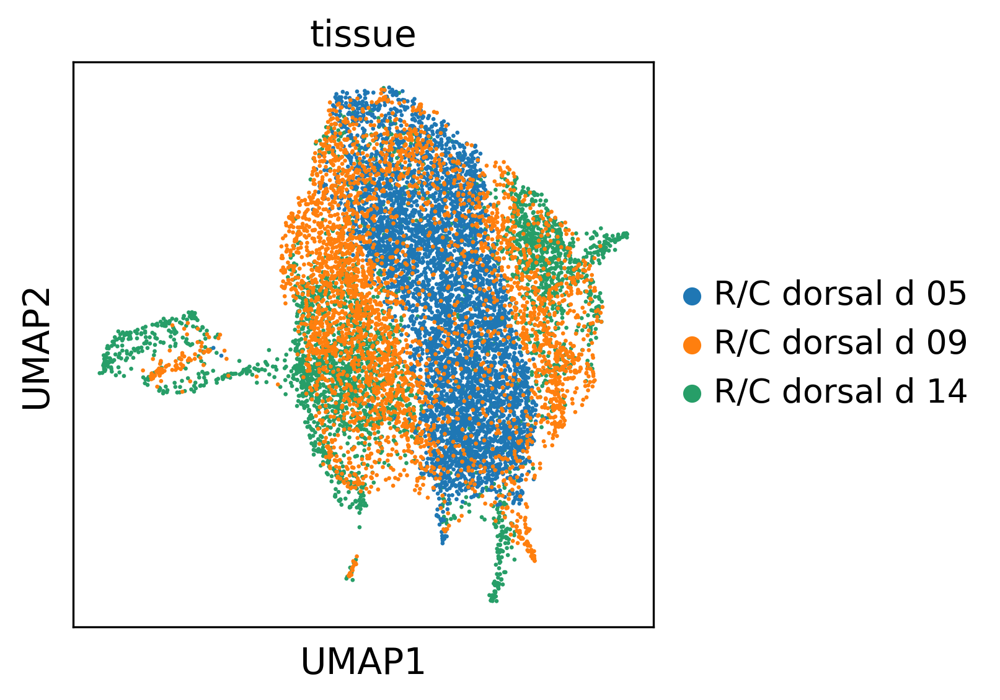

In [115]:

sc.pp.neighbors(MHB)
sc.tl.umap(MHB)
sc.pl.umap(MHB, color = ['tissue'], wspace= 0.5)



In [118]:
sc.tl.louvain(MHB,resolution=0.55)

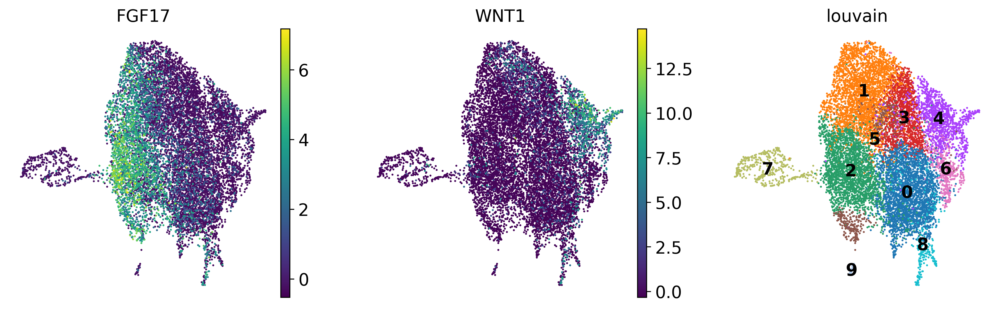

In [119]:
sc.pl.umap(MHB, color=['FGF17','WNT1','louvain'],frameon=False, legend_loc='on data')

In [92]:
#### make a copy for further analysis 
mhb_backup = MHB.copy()



In [93]:
del mhb_backup.obs['orig.ident']

In [94]:
#### write the dataset###
mhb_backup.write('/home/kgr851/python/mistr_atlas/figures/mhb_story/mhb_cells_dorsal_final.h5ad')

In [95]:
######since these cells are highly dividing we delete some cell cycle genes to look for top markers####
S_phase_genes = pd.read_csv('/home/kgr851/new_analysis_new_cc/cc/s.txt',header = None)[0]
G2M_phase_genes = pd.read_csv('/home/kgr851/new_analysis_new_cc/cc/g2m.txt',header = None)[0]


In [96]:
cc_g = np.in1d( MHB.var_names.values.astype(str), S_phase_genes,G2M_phase_genes)
MHB = MHB[:,~cc_g]

In [97]:
len(MHB.var_names)

20624

In [98]:
MHB.obs.groupby(['MHB','tissue']).apply(len)

MHB  tissue         
1    R/C dorsal d 05    5042
     R/C dorsal d 09    3604
     R/C dorsal d 14    3095
dtype: int64

/home/kgr851/.local/lib/python3.7/site-packages/scanpy/tools/_rank_genes_groups.py:409: RuntimeWarning: invalid value encountered in log2
  foldchanges[global_indices]


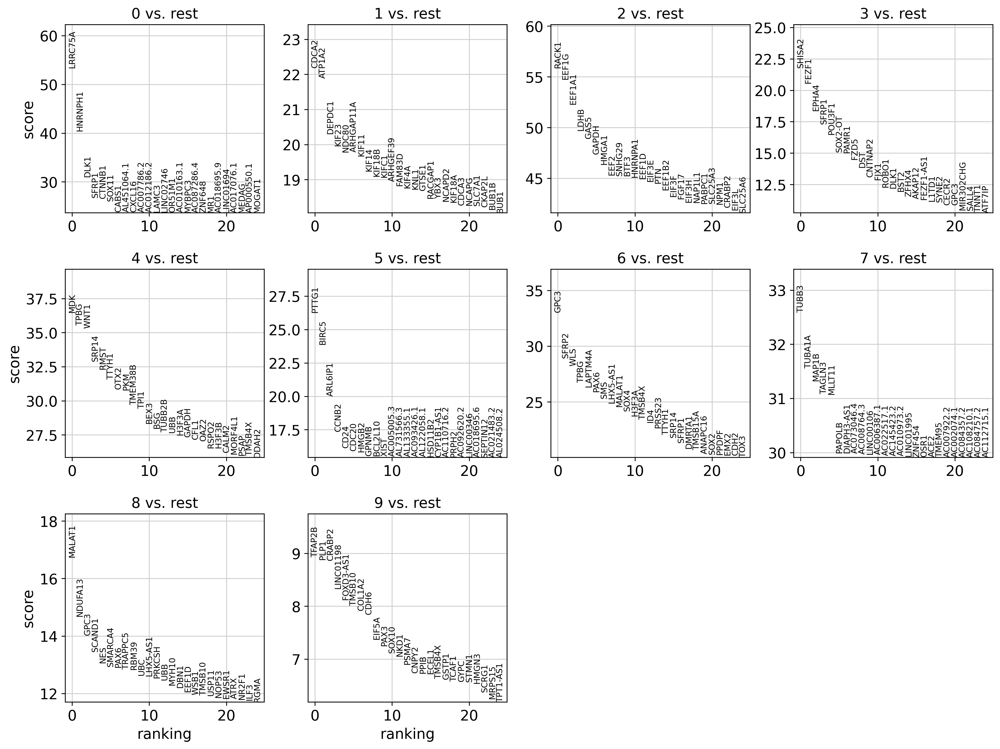

In [100]:
sc.tl.rank_genes_groups(MHB, 'louvain', method='wilcoxon', key_added = 'wilcoxon')
sc.pl.rank_genes_groups(MHB, n_genes=25, sharey=False,key = 'wilcoxon')

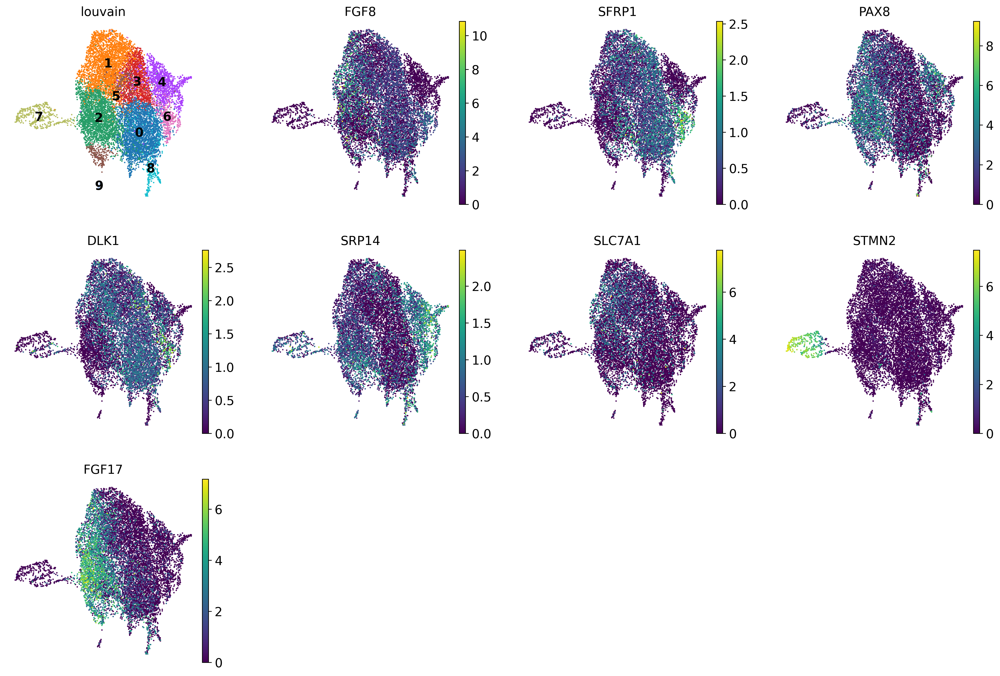

In [101]:
sc.pl.umap(MHB, color=['louvain','FGF8','SFRP1','PAX8','DLK1','SRP14','SLC7A1','STMN2','FGF17'], vmin = 0,frameon=False,legend_loc='on data' )

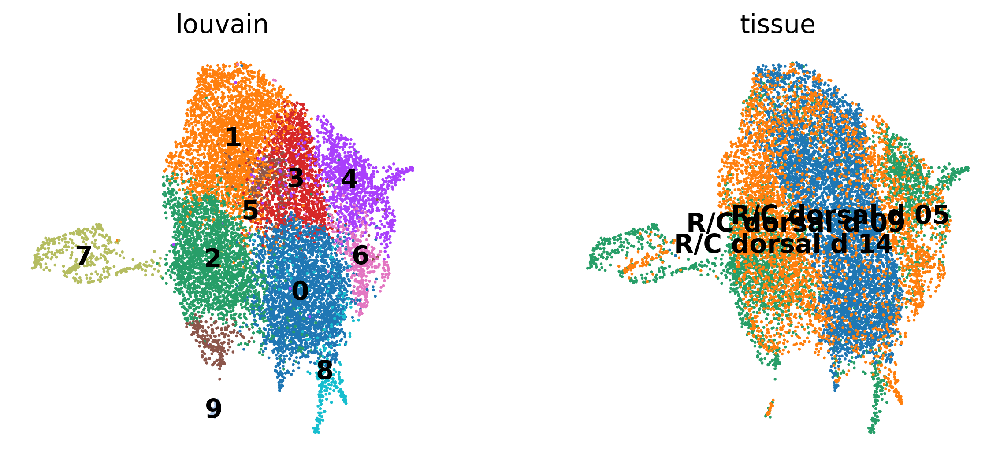

In [102]:
sc.pl.umap(MHB, color=['louvain','tissue'],frameon=False,legend_loc='on data', vmax = 2, color_map='YlGnBu' )

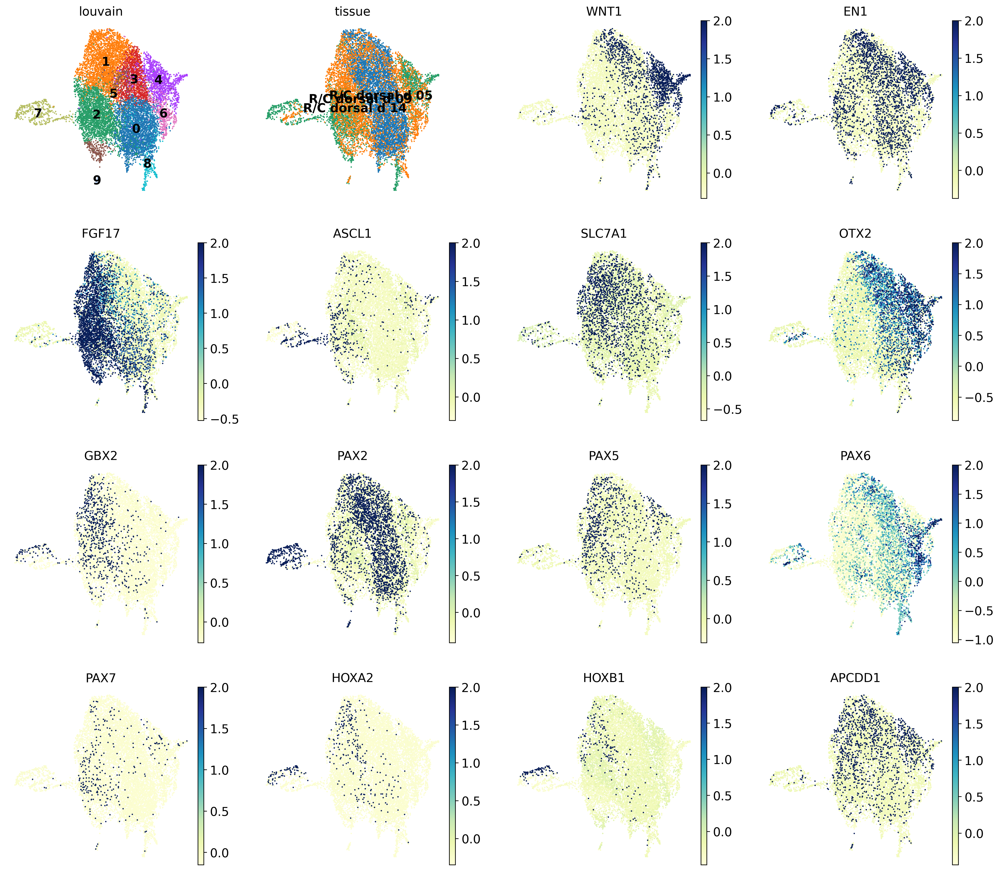

In [250]:
sc.pl.umap(MHB, color=['louvain','tissue','WNT1','EN1','FGF17','ASCL1','SLC7A1','OTX2','GBX2','PAX2' ,'PAX5','PAX6','PAX7','HOXA2','HOXB1','APCDD1'],
           frameon=False,legend_loc='on data', vmax = 2, color_map='YlGnBu',save = 'MHB_clustering_main_genes.svg' )

In [75]:
# #compare cluster1 genes, only stores top 100 by default

# wc = sc.get.rank_genes_groups_df(MHB, group='3', key='wilcoxon', pval_cutoff=0.01, log2fc_min=0)['names']
# tt = sc.get.rank_genes_groups_df(MHB, group='3', key='t-test', pval_cutoff=0.01, log2fc_min=0)['names']
# tt_ov = sc.get.rank_genes_groups_df(MHB, group='3', key='t-test_ov', pval_cutoff=0.01, log2fc_min=0)['names']

# from matplotlib_venn import venn3

# venn3([set(wc),set(tt),set(tt_ov)], ('Wilcox','T-test','T-test_ov') )
# plt.show()

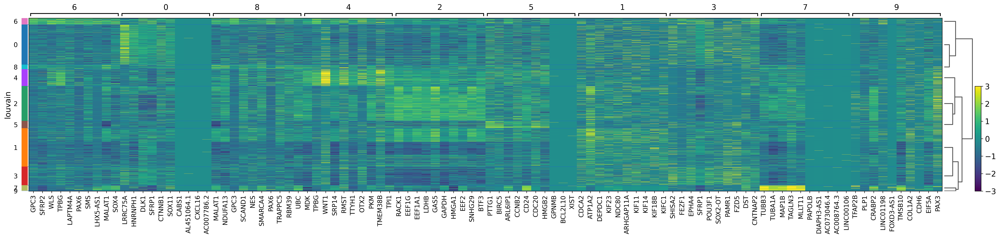

In [104]:

sc.pl.rank_genes_groups_heatmap(MHB, n_genes=10, key="wilcoxon", groupby="louvain", show_gene_labels=True, vmax = 3, vmin = -3, save = 'MHB_louvain_heatmap.svg')

In [249]:
##### save the processed dataset ###
MHB.write('mhb_cells_dorsal_norm_final.h5ad')